In [167]:
import torch
import torchsde
import matplotlib.pyplot as plt
from utils_6 import _stable_division

class GaussianDriftSDE(torchsde.SDEIto):
    def __init__(self, sigma=0.1):
        super(GaussianDriftSDE, self).__init__(noise_type="diagonal")
        self.sigma = sigma  # Diffusion coefficient
        self.theta = 1

    def mu_func(self, t):
        print('Mu func')
        mu_out = torch.tensor([10 * torch.exp(-((t - 5) / 5) ** 2)])
        mu_out = mu_out.unsqueeze(1)
        print('mu_out', mu_out.shape)
        return mu_out
    
    def prior_diext_dt(self,t):
        # Calculate factor
        factor = -2 * (t - 5) / 5
        # Calculate exponential
        exponential = torch.exp(-((t - 5) / 5) ** 2)
        # Calculate diext_dt and ensure it's of shape [batch x 1]
        diext_dt = torch.tensor([10 * factor * exponential])
        print('diext_dt', diext_dt.shape)
        return diext_dt.unsqueeze(1)
    
    def f(self, t, y):  # Approximate posterior drift.
         print('F')
         f_out = -2 * (y - 5) / 5 * torch.exp(-((y - 5) / 5)**2)
         print('f_out', f_out.shape)
         return f_out

    def g(self, t, y):
        print('G')
        print('y in G', y.shape)
        g = torch.full_like(y, fill_value=self.sigma)
        print('g', g.shape)
        return g

    def h(self, t, y):  # Prior drift.
        print('H')
        h_out = self.theta * (self.prior_diext_dt(t) - y[:,0].unsqueeze(1))
        print('h_out', h_out.shape)
        return h_out
    
    def h_aug(self, t, y):  # Drift for augmented dynamics with logqp term.
        y = y[:, 0].unsqueeze(1)
        f, g, h = self.f(t, y), self.g(t, y), self.h(t, y)
        u = _stable_division(f - h, g)
        f_logqp = .5 * (u ** 2).sum(dim=1, keepdim=True)
        h_out = torch.cat([h, f_logqp], dim=1)
        print('h aug out', h_out.shape)
        return h_out

    def f_aug(self, t, y):  # Drift for augmented dynamics with logqp term.

        print('Y f_aug', y.shape)

        f = self.f(t, y[:, 0].unsqueeze(1))
        g = self.g(t, y[:, 0].unsqueeze(1))
        h = self.h(t, y[:, 0].unsqueeze(1))
        print('f g h', f.shape, g.shape, h.shape)
        u = _stable_division(f - h, g)
        print('u', u.shape)
        f_logqp = .5 * (u ** 2).sum(dim=1, keepdim=True)
        f_out = torch.cat([f, f_logqp], dim=1)
        print('f_out', f_out.shape)
        return f_out

    def g_aug(self, t, y):  # Diffusion for augmented dynamics with logqp term.
        g = self.g(t, y[:,0].unsqueeze(1))
        print('g', g.shape)
        g_logqp = torch.zeros_like(y[:,0].unsqueeze(1))
        g_out = torch.cat([g, g_logqp], dim=1)
        print('g_out', g_out.shape)
        return g_out
    

# Example usage
num_samples = 10  # Define the number of sample paths
y0 = torch.full((num_samples, 1), 0., requires_grad=True)  # Initial states for all samples

print('y0', y0.shape)
aug_y0 = torch.cat([y0, torch.zeros(num_samples, 1).to(y0)], dim=1)
print('aug_y0', aug_y0.shape)

ts = torch.linspace(0, 10, 100)  # Time from 0 to 10
sde = GaussianDriftSDE(sigma = 0.1)
ys = torchsde.sdeint(sde, aug_y0, ts,
                      method='euler', 
                      names={'drift': 'h_aug', 'diffusion': 'g_aug'}) 



y0 torch.Size([10, 1])
aug_y0 torch.Size([10, 2])
F
f_out torch.Size([10, 1])
G
y in G torch.Size([10, 1])
g torch.Size([10, 1])
H
diext_dt torch.Size([1])
h_out torch.Size([10, 1])
h aug out torch.Size([10, 2])
G
y in G torch.Size([10, 1])
g torch.Size([10, 1])
g torch.Size([10, 1])
g_out torch.Size([10, 2])
F
f_out torch.Size([10, 1])
G
y in G torch.Size([10, 1])
g torch.Size([10, 1])
H
diext_dt torch.Size([1])
h_out torch.Size([10, 1])
h aug out torch.Size([10, 2])
G
y in G torch.Size([10, 1])
g torch.Size([10, 1])
g torch.Size([10, 1])
g_out torch.Size([10, 2])
F
f_out torch.Size([10, 1])
G
y in G torch.Size([10, 1])
g torch.Size([10, 1])
H
diext_dt torch.Size([1])
h_out torch.Size([10, 1])
h aug out torch.Size([10, 2])
G
y in G torch.Size([10, 1])
g torch.Size([10, 1])
g torch.Size([10, 1])
g_out torch.Size([10, 2])
F
f_out torch.Size([10, 1])
G
y in G torch.Size([10, 1])
g torch.Size([10, 1])
H
diext_dt torch.Size([1])
h_out torch.Size([10, 1])
h aug out torch.Size([10, 2])
G
y i

In [165]:
ys[-1, :, 1]

tensor([1370.4923, 1267.7751, 1291.2516, 1331.1805, 1240.6851, 1289.1591,
        1245.7090, 1341.7905, 1340.3894, 1328.5941], grad_fn=<SelectBackward0>)

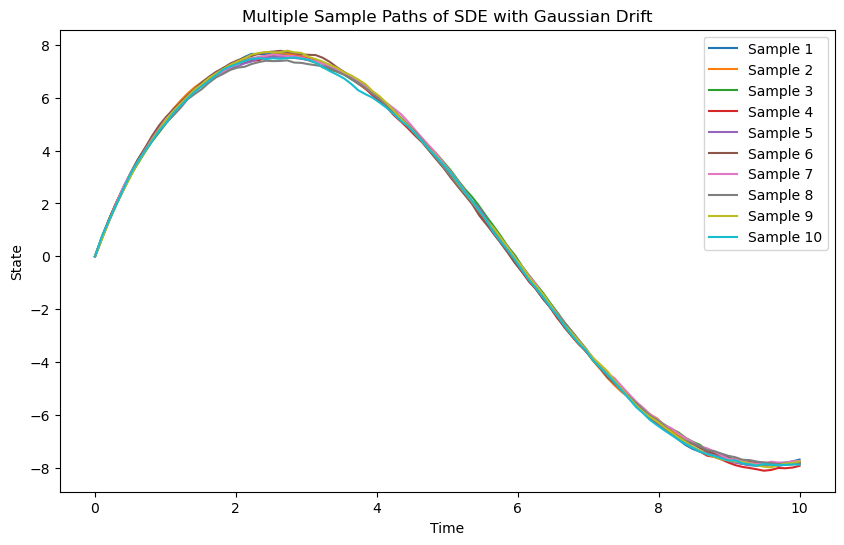

In [168]:
# Plotting
plt.figure(figsize=(10, 6))
for i in range(num_samples):
    plt.plot(ts.numpy(), ys[:, i, 0].detach().numpy(), label=f'Sample {i+1}')
plt.xlabel('Time')
plt.ylabel('State')
plt.title('Multiple Sample Paths of SDE with Gaussian Drift')
plt.legend()
plt.show()

In [94]:
import torch

def derivative_exp_function(t):
    """
    Compute the derivative of the function 5 * exp(-((t - 5) / 5) ** 2) with respect to t.
    
    Args:
    t (torch.Tensor): The input tensor for which the derivative is computed.
    
    Returns:
    torch.Tensor: The derivative of the function at each point in t.
    """
    # Calculate the factor that multiplies the exponential part
    factor = -2 * (t - 5) / 5

    # Calculate the exponential part
    exponential = torch.exp(-((t - 5) / 5) ** 2)

    # Return the product of the factor and the exponential part, scaled by 5
    return 5 * factor * exponential

# Example usage:
t = torch.linspace(0, 10, 100, requires_grad=False)  # Create a tensor of t values
derivative_values = derivative_exp_function(t)

#print(derivative_values)

tensor([ 3.6788,  3.7516,  3.8210,  3.8869,  3.9488,  4.0065,  4.0597,  4.1080,
         4.1513,  4.1891,  4.2213,  4.2475,  4.2675,  4.2811,  4.2880,  4.2879,
         4.2808,  4.2664,  4.2446,  4.2151,  4.1780,  4.1331,  4.0802,  4.0195,
         3.9508,  3.8741,  3.7895,  3.6970,  3.5967,  3.4887,  3.3731,  3.2502,
         3.1200,  2.9828,  2.8389,  2.6884,  2.5318,  2.3692,  2.2012,  2.0279,
         1.8498,  1.6673,  1.4808,  1.2907,  1.0975,  0.9016,  0.7035,  0.5038,
         0.3028,  0.1010, -0.1010, -0.3028, -0.5038, -0.7035, -0.9016, -1.0975,
        -1.2907, -1.4808, -1.6673, -1.8498, -2.0279, -2.2012, -2.3692, -2.5318,
        -2.6884, -2.8389, -2.9828, -3.1200, -3.2502, -3.3731, -3.4887, -3.5967,
        -3.6970, -3.7895, -3.8741, -3.9508, -4.0195, -4.0802, -4.1331, -4.1780,
        -4.2151, -4.2446, -4.2664, -4.2808, -4.2879, -4.2880, -4.2811, -4.2675,
        -4.2475, -4.2213, -4.1891, -4.1513, -4.1080, -4.0597, -4.0065, -3.9488,
        -3.8869, -3.8210, -3.7516, -3.67

In [47]:
import torch
import torchsde
import matplotlib.pyplot as plt
import numpy as np

class PhysiologicalSDE_batched(torchsde.SDEIto):
    def __init__(self, sigma, sigma_tx, params, confounder_type,non_confounded_effect):
        super(PhysiologicalSDE_batched, self).__init__(noise_type="diagonal")
        self.params = params
        self.sigma = sigma
        self.sigma_tx = sigma_tx
        self.confounder_type = confounder_type
        self.non_confounded_effect = non_confounded_effect

    def calculate_diext_dt(self,t, batch_size):
        # Assuming 't' might be a tensor with the shape [batch_size] or a scalar
        # Ensure 't' is at least 1D tensor with the shape [batch_size]
        t = t * torch.ones(batch_size)  # This line is only necessary if t might be a scalar

        # Calculate factor
        factor = -2 * (t - 5) / 5
        # Calculate exponential
        exponential = torch.exp(-((t - 5) / 5) ** 2)

        # Calculate diext_dt and ensure it's of shape [batch x 1]
        diext_dt = 5 * factor * exponential

        return diext_dt.unsqueeze(1)
    
    def create_treatment_effect(self):
        if self.confounder_type == 'visible':
            #confound on the initial NORMALISED PA - STATIC CONFOUNDER (not time dep)
            initp_transform  = 0.5+(self.params["confounding_pressure"]-0.75)/0.1
            ##print('initp_transform', initp_transform.shape)
            A_ = self.v_fun(initp_transform, scale = 0.02)
        elif self.confounder_type == 'partial':
            #confound on the initial NORMALISED SV - STATIC CONFOUNDER (not time dep)
            init_sv_transform  = 0.5+(self.params["confounding_sv"]-0.58)/0.1 
            print('init_sv_transform', init_sv_transform[0])
            A_ = self.v_fun(init_sv_transform, scale = 0.3)
        elif self.confounder_type == 'invisible':
            A_ = self.v_fun(self.params["confounder_random_number"])
        elif self.confounder_type == 'none':
            A_ = torch.tensor([1])
            
        self.treatment_effect = A_
        return A_

    def v_fun(self, x, scale):
        cos_term = torch.cos(5 * x - 0.2)
        square_term = (5 - x) ** 2
        return scale * (cos_term * square_term) ** 2

    def f(self, t, y):
        
        if t.item() >= 30:
            ##print(t)
            print('saving params')
            self.params["confounding_pressure"] = y[:, 0]
            self.params["confounding_sv"] = y[:, 3]
            self.params["cv"] = torch.rand_like(y[:, 0]) * 100 + 10 if self.non_confounded_effect else self.params["cv"] 
            self.params["confounder_random_number"] = torch.rand_like(y[:, 0])
            print('confounding_pressure', y[:, 0])
            print('confounding_sv', y[:, 3])
            A_ = self.create_treatment_effect()
        
        elif t.item() <30:
            A_ = torch.tensor([0])

        p_a = 100. * y[:, 0].unsqueeze(1)
        p_v = 100. * y[:, 1].unsqueeze(1)
        s = y[:, 2].unsqueeze(1)
        sv = 100. * y[:, 3].unsqueeze(1)
        i_ext = y[:, 4].unsqueeze(1)
        batch_size = y.shape[0]

        print('A_ ', A_)
        i_ext_tx_effect = A_.unsqueeze(1) * i_ext
        
        print('time, i_ext pre, A_, i_ext_post, pv, sv', t.item(),i_ext[0].item(), A_, i_ext_tx_effect[0].item(), p_v[0].item(), sv[0].item())   

        f_hr = s * (self.params["f_hr_max"] - self.params["f_hr_min"]) + self.params["f_hr_min"]
        r_tpr = s * (self.params["r_tpr_max"] - self.params["r_tpr_min"]) + self.params["r_tpr_min"] + self.params["r_tpr_mod"]

        dva_dt = -1. * (p_a - p_v) / r_tpr + sv * f_hr
        dvv_dt = -1. * dva_dt + i_ext_tx_effect
        dpa_dt = dva_dt / (self.params["ca"] * 100.)
        dpv_dt = dvv_dt / (self.params["cv"] * 10.)
        ds_dt = (1. / self.params["tau"]) * (1. - 1. / (1 + torch.exp(-self.params["k_width"] * (p_a - self.params["p_aset"]))) - s)
        dsv_dt = i_ext_tx_effect * self.params["sv_mod"]

        if self.params["treatment"] and (t >= self.params["t_treatment"]):
            #note that the 
            time_since_treatment = t - self.params["t_treatment"]
            diext_dt = self.calculate_diext_dt(time_since_treatment, batch_size)
            diext_dt = torch.relu(i_ext + diext_dt) - i_ext 
        else:
            #diext_dt = torch.full((batch_size, 1), 1)
            diext_dt = torch.zeros_like(dpa_dt)

        ##print('dpa_dt, dpv_dt, ds_dt, dsv_dt, diext_dt',dpa_dt.shape, dpv_dt.shape, ds_dt.shape, dsv_dt.shape, diext_dt.shape )
        
        diff_res = torch.concat([dpa_dt, dpv_dt, ds_dt, dsv_dt, diext_dt], dim=-1)
        print('diff_results example', diff_res[0,:])

        ##print('diff_res', diff_res.shape)
        return diff_res
    
    def g(self, t, y):
        diffusion = torch.full_like(y, self.sigma)
        if self.params["treatment"] and (t >= self.params["t_treatment"]):
            diffusion[:, 4] = self.sigma_tx
        return diffusion


In [48]:
def init_random_state_edited(low_sv):
    max_ves = 64.0 - 10.0
    min_ves = 36.0 + 10.0

    max_ved = 167.0 - 10.0
    min_ved = 121.0 + 10.0

    max_pa = 100.0
    min_pa = 85.0

    max_pv = 70.0
    min_pv = 30.0

    max_s = 0.05
    min_s = 0.01

    max_sv = 90
    min_sv = 83

    init_ves = (np.random.rand() * (max_ves - min_ves) + min_ves) / 100.0
    # init_ves = 50.0 / 100.0

    init_ved = (np.random.rand() * (max_ved - min_ved) + min_ved) / 100.0
    # init_ved = 144.0 / 100.0

    init_pa = (np.random.rand() * (max_pa - min_pa) + min_pa) / 100.0
    init_pv = (np.random.rand() * (max_pv - min_pv) + min_pv) / 100.0
    init_s = (np.random.rand() * (max_s - min_s) + min_s)
    init_sv = (np.random.rand() * (max_sv - min_sv) + min_sv) / 100.0

    init_i_ext = 0

    init_state = np.array([init_pa, init_pv, init_s, init_sv, init_i_ext])
    ##print('init_state', init_state)
    return init_state

In [49]:
import numpy as np
N=1000
init_state_list = []
for i in range(N):
    init_state_list.append(init_random_state_edited(low_sv=False))
init_state_tensor = torch.tensor(np.array(init_state_list), dtype=torch.float32)


In [87]:

params = {"r_tpr_mod": -0.5, #the mod is in case we want to simulate decreasing the total peripheral resistance i.e. shock
        "f_hr_max": 3.0,
        "f_hr_min": 2.0 / 3.0,
        "r_tpr_max": 2.134,
        "r_tpr_min": 0.5335,
        "sv_mod": 0.001,  ## this is also added on from the original model to simulate effect of fluid directly on the stroke volume
        "ca": 4.0,
        "cv": 111, #111.0

        # dS/dt parameters
        "k_width": 0.1838,
        "p_aset": 70,
        "tau": 20,
        "p_0lv": 2.03,
        "r_valve": 0.0025,
        "k_elv": 0.066,
        "v_ed0": 7.14,
        "T_sys": 4. / 15.,
        "cprsw_max": 103.8,
        "cprsw_min": 25.9,
        "t_treatment" : 45,
        'treatment': True
        }



sde = PhysiologicalSDE_batched(sigma = 0.0, sigma_tx=0, params = params, confounder_type='partial' , non_confounded_effect=False)

ts = torch.linspace(0, 60, 61)  # Time vector
ys = torchsde.sdeint(sde, init_state_tensor, ts, method='euler', dt = 0.05)

ys[:, :, 0] *= 100  
ys[:, :, 3] *= 100

A_  tensor([0])
time, i_ext pre, A_, i_ext_post, pv, sv 0.0 0.0 tensor([0]) 0.0 59.06376266479492 88.2926254272461
diff_results example tensor([-1.0629e+00,  3.8302e-01, -1.0216e-03,  0.0000e+00,  0.0000e+00])
A_  tensor([0])
time, i_ext pre, A_, i_ext_post, pv, sv 0.0 0.0 tensor([0]) 0.0 59.06376266479492 88.2926254272461
diff_results example tensor([-1.0629e+00,  3.8302e-01, -1.0216e-03,  0.0000e+00,  0.0000e+00])
A_  tensor([0])
time, i_ext pre, A_, i_ext_post, pv, sv 0.05000000074505806 0.0 tensor([0]) 0.0 60.97886657714844 88.2926254272461
diff_results example tensor([-8.3044e-01,  2.9926e-01, -4.5060e-04,  0.0000e+00,  0.0000e+00])
A_  tensor([0])
time, i_ext pre, A_, i_ext_post, pv, sv 0.10000000149011612 0.0 tensor([0]) 0.0 62.47514343261719 88.2926254272461
diff_results example tensor([-6.4818e-01,  2.3358e-01,  5.6134e-04,  0.0000e+00,  0.0000e+00])
A_  tensor([0])
time, i_ext pre, A_, i_ext_post, pv, sv 0.15000000596046448 0.0 tensor([0]) 0.0 63.64303970336914 88.29262542724

In [88]:

# Simulate
print(ys.shape)
y_sliced = ys[40:, :, :]
print(y_sliced.shape)
import os


def plot_selected_dimensions(ys, view_from, num_samples,title, save_dir, fig_size=(5, 7)):
    # Select K random samples from the data
    selected_samples = np.random.choice(ys.shape[1], num_samples, replace=False)
    
    # Slice data to only include the time steps from 40 onwards
    y_sliced = ys[view_from:, :, :]
    
    # Define the dimensions to plot
    dimensions = [0, 3, 4]
    dimension_labels = ['Arterial Pressure', 'Stroke Volume', 'Fluid Bolus']
    dimension_labels = ['Arterial Pressure', 'Stroke Volume', 'Infused fluid rate']
    y_labels = ['mmHg', 'milliliters (ml)', 'milliliters/second (ml/s)']
    
    # Setting up the plot
    fig, axs = plt.subplots(3, 1, figsize=fig_size, sharex=True)  # 3 plots, one for each dimension
    
    # Loop over the selected dimensions
    for idx, dim in enumerate(dimensions):
        ax = axs[idx]
        for sample in selected_samples:
            ax.plot(y_sliced[:, sample, dim], label=f'Sample {sample}')
        ax.set_title(dimension_labels[idx])
        ax.set_ylabel(y_labels[idx])
        ax.tick_params(axis='x', labelsize=10)
        ax.label_outer()
    axs[-1].set_xlabel('Time (seconds)', fontsize=12)

    plt.suptitle(title, fontsize=14)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    if save_dir != None:
        file_name = f"{title}_PaSvIext.png"
        final_save_path = os.path.join(save_dir, file_name)
        os.makedirs(os.path.dirname(final_save_path), exist_ok=True)
        plt.savefig(final_save_path)
        plt.close()  # Close the plot to free up memory
        print(f"Plot saved to {final_save_path}")
    else:
        plt.show()


save_dir = '/Users/riccardoconci/Local_documents/ACS submissions/THESIS/Counterfactual_ICU/Evaluations'

plot_selected_dimensions(ys, 40, 10, 'SV confounder \nTpr low', save_dir=save_dir)

torch.Size([61, 1000, 5])
torch.Size([21, 1000, 5])
Plot saved to /Users/riccardoconci/Local_documents/ACS submissions/THESIS/Counterfactual_ICU/Evaluations/SV confounder 
Tpr low_PaSvIext.png


A_  tensor([0])
time, i_ext pre, A_, i_ext_post, pv, sv 0.0 0.0 tensor([0]) 0.0 44.54880905151367 85.07479095458984
diff_results example tensor([-1.7370e+00,  6.2596e-01, -4.8224e-04,  0.0000e+00,  0.0000e+00])
A_  tensor([0])
time, i_ext pre, A_, i_ext_post, pv, sv 0.0 0.0 tensor([0]) 0.0 44.54880905151367 85.07479095458984
diff_results example tensor([-1.7370e+00,  6.2596e-01, -4.8224e-04,  0.0000e+00,  0.0000e+00])
A_  tensor([0])
time, i_ext pre, A_, i_ext_post, pv, sv 0.05000000074505806 0.0 tensor([0]) 0.0 47.67860412597656 85.07479095458984
diff_results example tensor([-1.2918,  0.4655,  0.0015,  0.0000,  0.0000])
A_  tensor([0])
time, i_ext pre, A_, i_ext_post, pv, sv 0.10000000149011612 0.0 tensor([0]) 0.0 50.00617599487305 85.07479095458984
diff_results example tensor([-0.9578,  0.3451,  0.0065,  0.0000,  0.0000])
A_  tensor([0])
time, i_ext pre, A_, i_ext_post, pv, sv 0.15000000596046448 0.0 tensor([0]) 0.0 51.73188018798828 85.07479095458984
diff_results example tensor([-0.

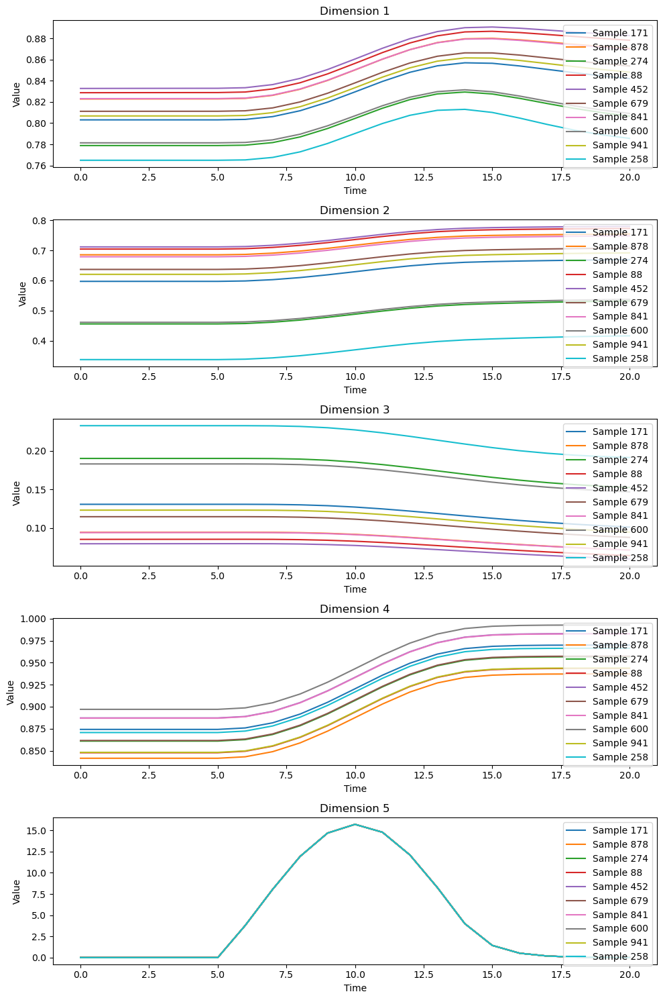

In [46]:


params = {"r_tpr_mod": -0.5, #the mod is in case we want to simulate decreasing the total peripheral resistance i.e. shock
        "f_hr_max": 3.0,
        "f_hr_min": 2.0 / 3.0,
        "r_tpr_max": 2.134,
        "r_tpr_min": 0.5335,
        "sv_mod": 0.001,  ## this is also added on from the original model to simulate effect of fluid directly on the stroke volume
        "ca": 4.0,
        "cv": 111.0,

        # dS/dt parameters
        "k_width": 0.1838,
        "p_aset": 70,
        "tau": 20,
        "p_0lv": 2.03,
        "r_valve": 0.0025,
        "k_elv": 0.066,
        "v_ed0": 7.14,
        "T_sys": 4. / 15.,
        "cprsw_max": 103.8,
        "cprsw_min": 25.9,
        "t_treatment" : 45,
        'treatment': True
        }



sde = PhysiologicalSDE_batched(sigma = 0.0, sigma_tx=0, params = params, confounder_type='none' , non_confounded_effect=False)

ts = torch.linspace(0, 60, 61)  # Time vector

# Simulate
ys = torchsde.sdeint(sde, init_state_tensor, ts, method='euler', dt = 0.05)


selected_samples = np.random.choice(1000, 10, replace=False)

# Setting up the plot
fig, axs = plt.subplots(5, 1, figsize=(10, 15))  # 3 plots, one for each dimension
for i in range(5):  # Loop over the first three dimensions
    for sample in selected_samples:
        axs[i].plot(ys[40:, sample, i], label=f'Sample {sample}')
    axs[i].set_title(f'Dimension {i+1}')
    axs[i].set_xlabel('Time')
    axs[i].set_ylabel('Value')
    axs[i].legend()  # Optional: Adds a legend if you want to track individual samples

plt.tight_layout()
plt.show()

In [146]:
ys.shape

torch.Size([61, 1000, 5])

In [162]:
sliced = ys[40:, :, :]
print(sliced.shape)
sliced.mean((0,1))

torch.Size([21, 1000, 5])


tensor([0.9025, 0.4668, 0.0408, 0.9490, 0.0000])

In [152]:
sliced = ys[50, :, :]
print(sliced.shape)
sliced.mean((0))

torch.Size([1000, 5])


tensor([0.9016, 0.4672, 0.0403, 0.9490, 0.0000])

In [79]:
init_transform  = 0.5+(0.9-0.2)/0.1
v_fun(init_transform)

0.6632733824520333

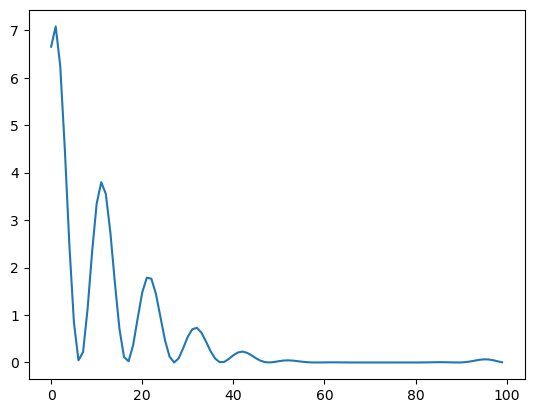

In [136]:

def v_fun(x):
    return 0.02*(np.cos(5*x-0.2) * (5-x)**2)**2


x = np.linspace(0.76,  1.36, 100)
init_transform  = 0.5+(x-0.75)/0.1

plt.plot(v_fun(init_transform))

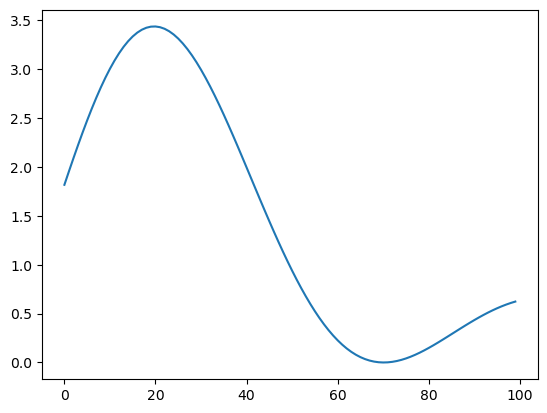

In [120]:
x = np.linspace(0.83,  0.90, 100)
init_transform  = 0.5+(x-0.58)/0.1

def v_fun_sv(x):
    return 0.3*(np.cos(5*x-0.2) * (5-x)**2)**2

plt.plot(v_fun_sv(init_transform))

In [2]:
import torch
import os

import torchsde
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset
from torch.utils.data import DataLoader, Subset
import lightning as L

from utils_7 import CV_params_prior_mu, CV_params_prior_sigma, CV_params

import torch
import torchsde
import matplotlib.pyplot as plt
import numpy as np

class PhysiologicalSDE_batched(torchsde.SDEIto):
    def __init__(self, sigma, sigma_tx, params, confounder_type,non_confounded_effect):
        super(PhysiologicalSDE_batched, self).__init__(noise_type="diagonal")
        self.params = params
        self.sigma = sigma
        self.sigma_tx = sigma_tx
        self.confounder_type = confounder_type
        self.non_confounded_effect = non_confounded_effect

    def calculate_diext_dt(self,t, batch_size):
        # Assuming 't' might be a tensor with the shape [batch_size] or a scalar
        # Ensure 't' is at least 1D tensor with the shape [batch_size]
        t = t * torch.ones(batch_size)  # This line is only necessary if t might be a scalar

        # Calculate factor
        factor = -2 * (t - 5) / 5
        # Calculate exponential
        exponential = torch.exp(-((t - 5) / 5) ** 2)

        # Calculate diext_dt and ensure it's of shape [batch x 1]
        diext_dt = 5 * factor * exponential

        return diext_dt.unsqueeze(1)
    
    def create_treatment_effect(self):
        #print('creating treatment effect')
        if self.confounder_type == 'visible':
            #confound on the initial NORMALISED PA - STATIC CONFOUNDER (not time dep)
            initp_transform  = 0.5+(self.params["confounding_pressure"]-0.75)/0.1
            ##print('initp_transform', initp_transform.shape)
            A_ = self.v_fun(initp_transform, scale = 0.02)
        elif self.confounder_type == 'partial':
            #confound on the initial NORMALISED SV - STATIC CONFOUNDER (not time dep)
            init_sv_transform  = 0.5+(self.params["confounding_sv"]-0.58)/0.1 
            #print('init_sv_transform', init_sv_transform[0])
            A_ = self.v_fun(init_sv_transform, scale = 0.3)
        elif self.confounder_type == 'invisible':
            A_ = self.v_fun(self.params["confounder_random_number"])
        elif self.confounder_type == 'none':
            A_ = torch.tensor([1])
            
        self.treatment_effect = A_
        return A_

    def v_fun(self, x, scale):
        cos_term = torch.cos(5 * x - 0.2)
        square_term = (5 - x) ** 2
        return scale * (cos_term * square_term) ** 2

    def f(self, t, y):
        
        if abs(t.item() - 40.0) < 0.001:
            ##print(t)
            #print('saving params')
            self.params["confounding_pressure"] = y[:, 0]
            self.params["confounding_sv"] = y[:, 3]
            self.params["cv"] = torch.rand_like(y[:, 0]) * 100 + 10 if self.non_confounded_effect else self.params["cv"] 
            self.params["confounder_random_number"] = torch.rand_like(y[:, 0])
            #print('confounding_pressure', y[:, 0])
            #print('confounding_sv', y[:, 3])
            A_ = self.create_treatment_effect()
        
        elif t.item() <40.0:
            A_ = torch.tensor([0])

        elif t.item()>40.0:
            A_ = self.create_treatment_effect()

        p_a = 100. * y[:, 0].unsqueeze(1)
        p_v = 100. * y[:, 1].unsqueeze(1)
        s = y[:, 2].unsqueeze(1)
        sv = 100. * y[:, 3].unsqueeze(1)
        i_ext = y[:, 4].unsqueeze(1)
        batch_size = y.shape[0]

        #print('A_ ', A_.shape)
        i_ext_tx_effect = A_.unsqueeze(1) * i_ext
        
        #print('time, i_ext pre, A_, i_ext_post, pv, sv', t.item(),i_ext[0].item(), A_[0], i_ext_tx_effect[0].item(), p_v[0].item(), sv[0].item())   

        f_hr = s * (self.params["f_hr_max"] - self.params["f_hr_min"]) + self.params["f_hr_min"]
        r_tpr = s * (self.params["r_tpr_max"] - self.params["r_tpr_min"]) + self.params["r_tpr_min"] - self.params["r_tpr_mod"]

        dva_dt = -1. * (p_a - p_v) / r_tpr + sv * f_hr
        dvv_dt = -1. * dva_dt + i_ext_tx_effect
        dpa_dt = dva_dt / (self.params["ca"] * 100.)
        dpv_dt = dvv_dt / (self.params["cv"] * 10.)
        ds_dt = (1. / self.params["tau"]) * (1. - 1. / (1 + torch.exp(-self.params["k_width"] * (p_a - self.params["p_aset"]))) - s)
        dsv_dt = i_ext_tx_effect * self.params["sv_mod"]

        if self.params["treatment"] and (t >= self.params["t_treatment"]):
            #note that the 
            time_since_treatment = t - self.params["t_treatment"]
            diext_dt = self.calculate_diext_dt(time_since_treatment, batch_size)
            diext_dt = torch.relu(i_ext + diext_dt) - i_ext 
        else:
            #diext_dt = torch.full((batch_size, 1), 1)
            diext_dt = torch.zeros_like(dpa_dt)

        ##print('dpa_dt, dpv_dt, ds_dt, dsv_dt, diext_dt',dpa_dt.shape, dpv_dt.shape, ds_dt.shape, dsv_dt.shape, diext_dt.shape )
        
        diff_res = torch.concat([dpa_dt, dpv_dt, ds_dt, dsv_dt, diext_dt], dim=-1)
        #print('diff_results example', diff_res[0,:])

        ##print('diff_res', diff_res.shape)
        return diff_res
    
    def g(self, t, y):
        diffusion = torch.full_like(y, self.sigma)
        if self.params["treatment"] and (t >= self.params["t_treatment"]):
            diffusion[:, 4] = self.sigma_tx
        return diffusion



def scale_numbers(x, original_min, original_max, target_min, target_max):
    return target_min + ((target_max - target_min) * (x - original_min) / (original_max - original_min))


def init_random_state():
    max_ves = 64.0 - 10.0
    min_ves = 36.0 + 10.0

    max_ved = 167.0 - 10.0
    min_ved = 121.0 + 10.0

    max_pa = 100.0
    min_pa = 85.0

    max_pv = 70.0
    min_pv = 30.0

    max_s = 0.05
    min_s = 0.01

    max_sv = 90
    min_sv = 83

    init_ves = (np.random.rand() * (max_ves - min_ves) + min_ves) / 100.0
    # init_ves = 50.0 / 100.0

    init_ved = (np.random.rand() * (max_ved - min_ved) + min_ved) / 100.0
    # init_ved = 144.0 / 100.0

    init_pa = (np.random.rand() * (max_pa - min_pa) + min_pa) / 100.0
    init_pv = (np.random.rand() * (max_pv - min_pv) + min_pv) / 100.0
    init_s = (np.random.rand() * (max_s - min_s) + min_s)
    init_sv = (np.random.rand() * (max_sv - min_sv) + min_sv) / 100.0

    init_i_ext = 0

    init_state = np.array([init_pa, init_pv, init_s, init_sv, init_i_ext])
    ##print('init_state', init_state)
    return init_state


def create_cv_data(include_all_inputs, N,gamma,noise_std, sigma_tx, r_tpr_mod, confounder_type, non_confounded_effect, t_span, t_treatment, t_cutoff, seed, post_treatment_dims, pre_treatment_dims, normalize = False):

    np.random.seed(seed)

    X = []
    Y_0 = []
    Y_1 = []
    init_state_list = []
    
    params = {"r_tpr_mod": r_tpr_mod, #the mod is in case we want to simulate decreasing the total peripheral resistance i.e. shock
            "f_hr_max": 3.0,
            "f_hr_min": 2.0 / 3.0,
            "r_tpr_max": 2.134,
            "r_tpr_min": 0.5335,
            "sv_mod": 0.001,  ## this is also added on from the original model to simulate effect of fluid directly on the stroke volume
            "ca": 4.0,
            "cv": 111.0,

            # dS/dt parameters
            "k_width": 0.1838,
            "p_aset": 70,
            "tau": 20,
            "t_treatment" : t_treatment,
            }
    
    params_treatment = params.copy()
    params_treatment["treatment"]=True
    params_notreatment = params.copy()
    params_notreatment["treatment"]=False

    params_for_output = params.copy()
    

    t = np.arange(t_span).astype(float)
    t_tensor = torch.tensor(t, dtype=torch.float32)

    #print(f"N: {N}")
    #print(f"Gamma: {gamma}")
    #print(f"Noise Std: {noise_std}")
    #print(f"Sigma Tx: {sigma_tx}")
    #print(f"Confounder Type: {confounder_type}")
    #print(f"Non Confounded Effect: {non_confounded_effect}")
    #print(f"t_span: {t_span}")
    #print(f"t_treatment: {t_treatment}")
    #print(f"Seed: {seed}")
    #print(f"Post Treatment Dims: {post_treatment_dims}")
    #print(f"Pre Treatment Dims: {pre_treatment_dims}")
    #print(f"Normalize: {normalize}")

    #print('creating initial random states for both treated and untreated ')
    init_state_list = []
    for i in range(N):
        init_state_list.append(init_random_state())
    init_state_tensor = torch.tensor(np.array(init_state_list), dtype=torch.float32)

    #creating treated from those initial random states
    #print('creating treated')
    print('init_state_tensor', init_state_tensor.shape, 't_tensor', t_tensor.shape, )
    sde = PhysiologicalSDE_batched(sigma = noise_std, sigma_tx=sigma_tx, confounder_type=confounder_type , non_confounded_effect = non_confounded_effect, params=params_treatment)
    Y_1 = torchsde.sdeint(sde, init_state_tensor, t_tensor, method='euler',dt=0.05).squeeze(1)

    #print('creating untreated')
    #created untreated from the same initial random satates
    sde = PhysiologicalSDE_batched(sigma = noise_std, sigma_tx=sigma_tx, confounder_type=confounder_type , non_confounded_effect = non_confounded_effect, params=params_notreatment)
    Y_0 = torchsde.sdeint(sde, init_state_tensor, t_tensor, method='euler', dt=0.05).squeeze(1)

    print('Y0 Y1', Y_0.shape, Y_1.shape)
    X = Y_0[t_cutoff, :, :]
    init_state = Y_0[t_cutoff, :, :] #the confounder is not based on the 'initial' values but rather the ones just before treatment 
        
    #print('Assigning confounding factors')
    ##print('init_state', init_state.shape)
    if confounder_type == 'visible':
        scaled_pa = scale_numbers(x=init_state[:, 0], original_min=0.85, original_max=1.0, target_min=0, target_max=1)
        p = torch.sigmoid(gamma*scaled_pa) # use the arterial pressure as visible confounder
    
    elif confounder_type == 'partial':# use the stroke volume as a partially visible confounder
        scaled_sv = scale_numbers(x=init_state[:, 3], original_min=0.83, original_max=0.9, target_min=0, target_max=1)
        p  = torch.sigmoid(gamma*scaled_sv) 

    elif confounder_type == 'invisible':
        p =  torch.sigmoid(gamma*torch.rand(N)) 

    ##print('p', p.shape)
    T = torch.zeros(N)
    #T determines which trajectories as selected as treated (overlap level is controlled by gamma)
    T[torch.rand(N)<p] = 1

    #all_trajectories = torch.cat([Y_0, Y_1], dim = 1)
    Y_0 = Y_0[:, :, :4].permute(1, 0, 2)  # drop the dim used to create I-external and permute to [batch, seq_len, dim]
    Y_1 = Y_1[:, :, :4].permute(1, 0, 2)
    T_expanded = T[:, None, None]
    #print('Y0, Y1, T_expanded', Y_0.shape, Y_1.shape, T_expanded.shape)
    print('Y0 Y1 permuted', Y_0.shape, Y_1.shape)
    # the 'factual' trajectories are the UNtreated outcome (Y0) for the not Treated (1-T) and the Treated outcome (Y1) for the factually Treated (T)
    Y_fact = Y_0 * (1-T_expanded)+ Y_1 *T_expanded

    # the 'COUNTERfactual' trajectories are the UNtreated outcome (Y0) for the Treated (T) and the Treated outcome (Y1) for the factually UNtreated (1-T)
    # we would never actually have access to the counterfactual other than in this situation where we are simulating it 
    Y_cf = Y_0 * T_expanded + Y_1 * (1-T_expanded)

    print('Y_fact Y_cf', Y_fact.shape, Y_cf.shape)
    Y_fact = Y_fact[:, t_cutoff:, :]
    Y_cf = Y_cf[:, t_cutoff:, :]

    Y_fact_np = Y_fact.detach().cpu().numpy()
    states_mean = Y_fact_np.mean(axis=(0, 1))
    states_min = Y_fact_np.min(axis=(0, 1))
    states_max = Y_fact_np.max(axis=(0, 1))
    #print('states_mean', states_mean, 'states_min', states_min, 'states_max', states_max)

    Y_fact_until_t = Y_fact[:, :t_treatment-t_cutoff, :]
    print('Y_fact_until_t', Y_fact_until_t.shape)
    mu = Y_fact_until_t.mean((0,1))
    std = Y_fact_until_t.std((0,1))
    print('mu', mu.shape)
    print('std', std.shape)
    
    if normalize:
        Y_fact = (Y_fact - mu)/std
        Y_cf = (Y_cf - mu)/std
        mu_X = X.mean([0,1])
        std_X = X.std([0,1])
        X = (X-mu_X)/std_X

    CV_params_prior_mu['pa'] = mu[0]*100
    CV_params_prior_mu['pv'] = mu[1] *100
    CV_params_prior_mu['s'] = mu[2]
    CV_params_prior_mu['sv'] = mu[3] *100

    CV_params_prior_sigma['pa'] = std[0]*100
    CV_params_prior_sigma['pv'] = std[1]*100
    CV_params_prior_sigma['s'] = std[2]
    CV_params_prior_sigma['sv'] = std[3]*100

    CV_params['max_pa'] = (mu[0] + 2.5 * std[0]) * 100
    CV_params['min_pa'] = (mu[0] - 2.5 * std[0]) * 100
    CV_params['max_pv'] = (mu[1] + 2.5 * std[1]) * 100
    CV_params['min_pv'] = (mu[1] - 2.5 * std[1]) * 100
    CV_params['max_s'] = (mu[2] + 2.5 * std[2]) 
    CV_params['min_s'] = (mu[2] - 2.5 * std[2]) 
    CV_params['max_sv'] = (mu[3] + 2.5 * std[3]) * 100
    CV_params['min_sv'] = (mu[3] - 2.5 * std[3]) * 100

    
    # Now split these factual and counterfactual trajectories by the 'before' and 'after treatment' so we have a baseline 
    
    pre_treat_mask = (t<=t_treatment)[t_cutoff:]
    post_treat_mask = (t>t_treatment)[t_cutoff:]

    print('pre_treat_mask', pre_treat_mask.shape)
    print('post_treat_mask', post_treat_mask.shape)

    # We define X as the Factual trajectory BEFORE treatment, and X_ as the COUNTERfactual traj BEFORE treatment 
    X_static = X
    if include_all_inputs:
        X = Y_fact[:,pre_treat_mask]
    else:
        X = Y_fact[:,pre_treat_mask][:,:,pre_treatment_dims]
        X_ = Y_cf[:,pre_treat_mask][:,:,pre_treatment_dims]

    print('X', X.shape)

    # We redfine Y_fact as the Factual trajectory AFTER treatment, and Y_cf as the COUNTERfactual traj AFTER treatment 
    # We are selecting the DIASTOLIC BP (output dim = 1) as the one to maintain.. this is because the fluid is only really affecting this within the time values
    full_fact_traj = Y_fact
    full_CF_traj = Y_cf

    print('full_fact_traj', full_fact_traj.shape)
    print('full_CF_traj', full_CF_traj.shape)


    Y_fact = Y_fact[:,post_treat_mask][:,:,post_treatment_dims]
    Y_cf = Y_cf[:,post_treat_mask][:,:,post_treatment_dims]

    print('Y_fact', Y_fact.shape)
    print('Y_cf',Y_cf.shape)

    # we split the time vector also as before and after treatment 
    t_new = np.arange(t_span - t_cutoff)
    t_x = t_new[pre_treat_mask]
    t_y = t_new[post_treat_mask]

    print('t_x', t_x.shape)
    print('t_y', t_y.shape)
    # and get it to match the dimensions, so it's not a vector t, but a matrix of dimensions N by before_tx and N by after_tx
    t_X = torch.Tensor(np.tile(t_x[None,:],(X.shape[0],1)))
    t_Y = torch.Tensor(np.tile(t_y[None,:],(Y_fact.shape[0],1))) - t_x[-1]
    t_FULL = torch.tensor(t_new).unsqueeze(0).repeat(X.shape[0], 1)
    expert_ODE_size = X.shape[1] - 1 #need to remove the i_ext which is only for creating data not models

    if include_all_inputs:
        params_tensor = torch.tensor(list(params_for_output.values()), dtype=torch.float32)  # Shape: [11]
        params_tensor = params_tensor.reshape(1, 1, -1)
        print('params_tensor', params_tensor.shape)
        params_tensor_X = params_tensor.expand(N, X.shape[1], -1)[:, :, :-1] #remove t_treatment
        params_tensor_full = params_tensor.expand(N, full_fact_traj.shape[1], -1)[:, :, :-1] #remove t_treatment
        print('params_tensor_X', params_tensor_X.shape)
        print('params_tensor_full', params_tensor_full.shape)

        full_fact_traj = torch.cat([full_fact_traj, params_tensor_full], dim=-1)
        full_CF_traj = torch.cat([full_fact_traj, params_tensor_full], dim=-1)
        X = torch.cat([X, params_tensor_X], dim=-1)  


    return X, X_static, T, Y_fact, Y_cf, p, init_state, t_X, t_Y, expert_ODE_size, t_FULL, full_fact_traj,full_CF_traj, sde




In [3]:
dataset_params = {'include_all_inputs':True, 
        'N': 1280,
        'gamma': 5,
        'noise_std': 0.0,
        'r_tpr_mod':0.5,
        'sigma_tx': 2,
        'confounder_type': 'partial',
        'non_confounded_effect': False,
        't_span': 60,
        't_treatment': 45,
        't_cutoff':40,
        'seed': 1,
        'pre_treatment_dims': [0, 1],
        'post_treatment_dims': [0],
        'normalize': False,
    }

X, X_static, T, Y_fact, Y_cf, p, init_state, t_X, t_Y, expert_ODE_size, t_FULL, full_fact_traj,full_CF_traj, sde = create_cv_data(include_all_inputs = dataset_params['include_all_inputs'], 
                                                                                                                                          N = dataset_params['N'],
                                                                                                                                      gamma = dataset_params['gamma'],
                                                                                                                                      noise_std = dataset_params['noise_std'], 
                                                                                                                                      r_tpr_mod = dataset_params['r_tpr_mod'],
                                                                                                                                      sigma_tx = dataset_params['sigma_tx'], 
                                                                                                                                      confounder_type = dataset_params['confounder_type'], 
                                                                                                                                      non_confounded_effect = dataset_params['non_confounded_effect'], 
                                                                                                                                      t_span = dataset_params['t_span'], 
                                                                                                                                      t_treatment = dataset_params['t_treatment'], 
                                                                                                                                      t_cutoff = dataset_params['t_cutoff'],
                                                                                                                                      seed = dataset_params['seed'], 
                                                                                                                                      post_treatment_dims = dataset_params['post_treatment_dims'], 
                                                                                                                                      pre_treatment_dims = dataset_params['pre_treatment_dims'], 
                                                                                                                                      normalize = dataset_params['normalize'])

init_state_tensor torch.Size([1280, 5]) t_tensor torch.Size([60])
Y0 Y1 torch.Size([60, 1280, 5]) torch.Size([60, 1280, 5])
Y0 Y1 permuted torch.Size([1280, 60, 4]) torch.Size([1280, 60, 4])
Y_fact Y_cf torch.Size([1280, 60, 4]) torch.Size([1280, 60, 4])
Y_fact_until_t torch.Size([1280, 5, 4])
mu torch.Size([4])
std torch.Size([4])
pre_treat_mask (20,)
post_treat_mask (20,)
X torch.Size([1280, 6, 4])
full_fact_traj torch.Size([1280, 20, 4])
full_CF_traj torch.Size([1280, 20, 4])
Y_fact torch.Size([1280, 14, 1])
Y_cf torch.Size([1280, 14, 1])
t_x (6,)
t_y (14,)
params_tensor torch.Size([1, 1, 12])
params_tensor_X torch.Size([1280, 6, 11])
params_tensor_full torch.Size([1280, 20, 11])


In [4]:
Y_fact.shape

torch.Size([1280, 14, 1])

In [70]:
Y_fact_hat = Y_fact.unsqueeze(1) + torch.randn_like(Y_fact.unsqueeze(1))
Y_cf_hat = Y_cf.unsqueeze(1) + + torch.randn_like(Y_fact.unsqueeze(1))

In [73]:
Y_cf_hat.permute(0, 2, 1, 3).shape

torch.Size([1000, 14, 1, 1])

In [75]:
plot_factuals_counterfactuals( X[:, :, :2], Y_fact, Y_cf, Y_fact_hat.permute(0, 2, 1, 3), Y_cf_hat.permute(0, 2, 1, 3), chart_type = "val", train_dir = '.', global_step = 0, log_wandb = False )


Y_hat torch.Size([1000, 14, 1])
Y_hat_cf torch.Size([1000, 14, 1])
time_x (6,)
time_y (14,)
Saved figure at: ./Predictions_global_step_0.png


In [88]:
import numpy as np
import plotly.graph_objects as go
import os

class ModelEvaluator:
    def __init__(self, num_batches=10, num_steps=5, train_dir='.'):
        self.num_batches = num_batches
        self.num_steps = num_steps
        self.train_dir = train_dir
        self.mse_data_factual = [[] for _ in range(num_batches)]
        self.mse_data_cf = [[] for _ in range(num_batches)]
        
        if not os.path.exists(self.train_dir):
            os.makedirs(self.train_dir)

    def simulate_mse_data(self):
        # Simulate MSE data for both factual and counterfactual scenarios
        for step in range(self.num_steps):
            for i in range(self.num_batches):
                mse_factual = 1 / (step + 1) + np.random.normal(0, 0.1)
                mse_cf = 1 / (step + 1) + np.random.normal(0, 0.2)
                self.mse_data_factual[i].append(mse_factual)
                self.mse_data_cf[i].append(mse_cf)

    def plot_mse_evolution(self):
        # Determine the initial sorting order based on the first validation step's MSE values
        initial_mse_values = [self.mse_data_factual[i][0] for i in range(self.num_batches)]
        sorted_indices = np.argsort(initial_mse_values)[::-1]  # Sort descending

        fig = go.Figure()

        # Plot MSE evolution for each validation step
        for step in range(self.num_steps):
            # Get MSE values for this step across all batches using the initial sort order
            step_mse_values = [self.mse_data_factual[i][step] for i in sorted_indices]

            # Create a trace for this validation step
            fig.add_trace(go.Scatter(
                x=list(range(self.num_batches)),  # X-axis is the fixed sorted index of the batch
                y=step_mse_values,  # Y-axis is the MSE values in the initial sorted order
                mode='lines+markers',
                line=dict(color='rgba(0, 0, 255, {})'.format((self.num_steps - step) / self.num_steps), width=2),
                name=f'Validation Step {step + 1}'
            ))

        fig.update_layout(
            title="MSE Evolution Across Validation Steps (Sorted by Initial MSE)",
            xaxis_title="Batch Index (sorted by initial MSE)",
            yaxis_title="MSE Value",
            legend_title="Validation Step"
        )

        plot_filename = os.path.join(self.train_dir, 'mse_evolution_sorted.png')
        fig.write_image(plot_filename, engine="kaleido")
        print(f"Plot saved to {plot_filename}")

# Example usage
evaluator = ModelEvaluator(num_batches=10, num_steps=5)
evaluator.simulate_mse_data()
evaluator.plot_mse_evolution()

Plot saved to ./mse_evolution_sorted.png
